In [ ]:
import numpy as np
import pandas as pd
import os
for dirname, _, filenames in os.walk('/kaggle/input/../input/united-utilities-water-management-water-demand/netbase_inlet-outlet-cont_logged_user_April2018.csv'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# **Importing Libraries**

In [ ]:
import numpy as np
import pandas as pd
from matplotlib import pyplot as plt
import seaborn as sns

import tensorflow as tf
import sklearn

from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM,  GRU
from tensorflow.keras.layers import Dense, Dropout

from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error

#from datetime import datetime
from keras.preprocessing.sequence import TimeseriesGenerator
from keras.layers import LeakyReLU

**Loading Dataset**

In [ ]:
df = pd.read_csv('netbase_inlet-outlet-cont_logged_user_April2018.csv')#import CSV file of data

In [ ]:
df.head()

,Date,074-01 : \nLongridge : \nNetflow Stored \n(l/s),"074-03 : \nPreston Road, \nLongridge : \nNetflow Stored \nMinus Cont \nLogged (l/s)",074-04 : \nWhittingham \nRoad : Netflow \nStored (l/s),074-11 : \nRibchester \nVillage : \nNetflow Stored \nMinus Cont \nLogged (l/s),074-02 : Tan \nYard Lane : \nNetflow Stored \n(l/s),[Continuous] \nMeter : \n207330265 : MR \nCOULSTON T/A \nRIBBLE FARM \nFAYRE : Flow \nWith Edits \n(l/s),[Continuous] \nMeter : 6924916 \n: NO CUSTOMER : \nFlow With Edits \n(l/s),[Continuous] \nMeter : 5680357 \n: F TALBOT & CO \n: Flow With \nEdits (l/s)
0,01/04/2018 00:00,-3.370818,4.622,12.244,NaN,8.889,NaN,NaN,0.044
1,01/04/2018 00:15,-3.286014,4.211,12.711,NaN,8.889,NaN,NaN,0.033
2,01/04/2018 00:30,-1.771281,3.644,10.978,NaN,8.556,NaN,NaN,0.033
3,01/04/2018 00:45,-1.574651,3.578,10.622,NaN,8.333,NaN,NaN,0.022
4,01/04/2018 01:00,-0.593511,3.422,9.622,NaN,8.111,NaN,NaN,0.044


**Preprocessing**

In [ ]:
#Renaming the Columns for make them easy to use
df.rename(columns = {' Date ':'Date','074-01 : \nLongridge : \nNetflow Stored \n(l/s)':'074-01','074-03 : \nPreston Road, \nLongridge : \nNetflow Stored \nMinus Cont \nLogged (l/s)':'074-03',
                     '074-04 : \nWhittingham \nRoad : Netflow \nStored (l/s)':'074-04','074-11 : \nRibchester \nVillage : \nNetflow Stored \nMinus Cont \nLogged (l/s)':'074-11','074-02 : Tan \nYard Lane : \nNetflow Stored \n(l/s)':'074-02', '[Continuous] \nMeter : \n207330265 : MR \nCOULSTON T/A \nRIBBLE FARM \nFAYRE : Flow \nWith Edits \n(l/s)':'MR_COULSTON_RIB_Farm', '[Continuous] \nMeter : 6924916 \n: NO CUSTOMER : \nFlow With Edits \n(l/s)':'NO_CUSTOMER',
                     '[Continuous] \nMeter : 5680357 \n: F TALBOT & CO \n: Flow With \nEdits (l/s)':'F_TALBOT_CO'}, inplace = True)

In [ ]:
df.describe()

,074-01,074-03,074-04,074-11,074-02,MR_COULSTON_RIB_Farm,NO_CUSTOMER,F_TALBOT_CO
count,125100.000000,138168.000000,127746.000000,84641.000000,135442.000000,28915.000000,32184.000000,116500.000000
mean,11.115183,6.395253,7.521118,3.097020,8.815061,0.151019,0.189941,0.467517
std,9.524592,4.946648,5.680721,1.185755,5.481461,0.127092,0.370571,0.413734
min,-337.999312,-1.934000,0.000000,-85.445000,-25.122000,0.004000,0.000000,0.000000
25%,6.551229,4.069000,4.111000,2.166000,6.778000,0.034000,0.000000,0.289000
50%,11.262848,6.656000,7.889000,3.278000,8.778000,0.129000,0.000000,0.456000
75%,14.707181,7.971000,9.778000,3.933000,10.556000,0.233000,0.222000,0.611000
max,79.755246,238.380000,351.056000,7.422000,167.533000,0.524000,2.600000,90.689000


In [ ]:
df.drop(['MR_COULSTON_RIB_Farm' , 'NO_CUSTOMER' , 'F_TALBOT_CO'], axis=1, inplace=True)

In [ ]:
df.shape

(140086, 6)

In [ ]:
#check the number of missing values
df.isnull().sum()

Date          0
074-01    14986
074-03     1918
074-04    12340
074-11    55445
074-02     4644
dtype: int64

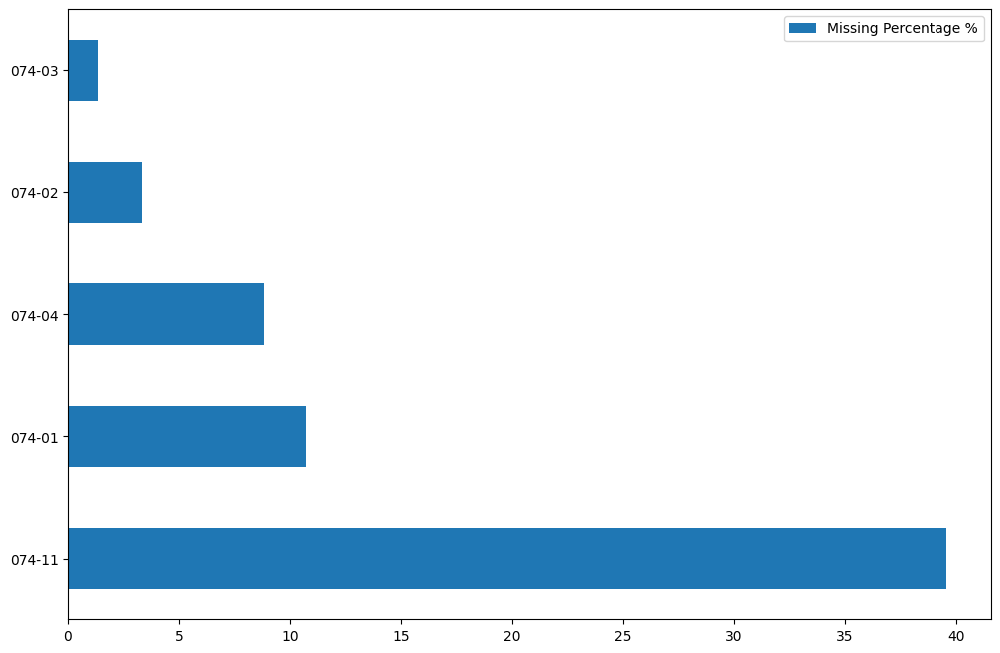

In [ ]:
# percentage of null values of each columnn.
def plot_nas(df: pd.DataFrame):
    if df.isnull().sum().sum() != 0:
        na_df = (df.isnull().sum() / len(df)) * 100
        na_df = na_df.drop(na_df[na_df == 0].index).sort_values(ascending=False)
        missing_data = pd.DataFrame({'Missing Percentage %' :na_df})
        missing_data.plot(kind = "barh")
        plt.show()
    else:
        print('No NAs found')
plt.rcParams["figure.figsize"] = (12,8)
plot_nas(df)

In [ ]:
null_Percentage = pd.DataFrame((df.isnull().sum() / len(df)) * 100)

In [ ]:
#Null values percentage of each column.
null_Percentage.rename(columns={0:'Percentage '})

,Percentage
Date,0.000000
074-01,10.697714
074-03,1.369159
074-04,8.808875
074-11,39.579258
074-02,3.315106


## **Visualization of Raw data**

In [ ]:
# Using plotly.express
import plotly.express as px
fig = px.line(df, x='Date', y='074-01',labels={
                     "Date": "Date",
                     "074-01": "074-01 Flow  l/s",

                 })
fig.show()

In [ ]:
px.line(df, x='Date', y='074-03', labels={
                     "Date": "Date",
                     "074-03": "074-03 Flow  l/s",

                 })

In [ ]:
px.line(df, x='Date', y='074-04', labels={
                     "Date": "Date",
                     "074-04": "074-04 Flow  l/s",

                 })

In [ ]:
px.line(df, x='Date', y='074-11', labels={
                     "Date": "Date",
                     "074-11": "074-11 Flow  l/s",

                 })

In [ ]:
px.line(df, x='Date', y='074-02',  labels={
                     "Date": "Date",
                     "074-02": "074-02 Flow  l/s",

                 })

**Visulazation of Raw Data year wise**

In [ ]:
df=df[['074-01', '074-03', '074-04', '074-11', '074-02']]
df_date = pd.date_range(pd.Timestamp("2018-04-01 00:00"),"2022-03-30 05:15" , freq='15Min')
df_date= pd.DataFrame(df_date)
df_date.rename(columns={0:'Date'}, inplace=True)
df= pd.concat([df_date,df], axis=1)

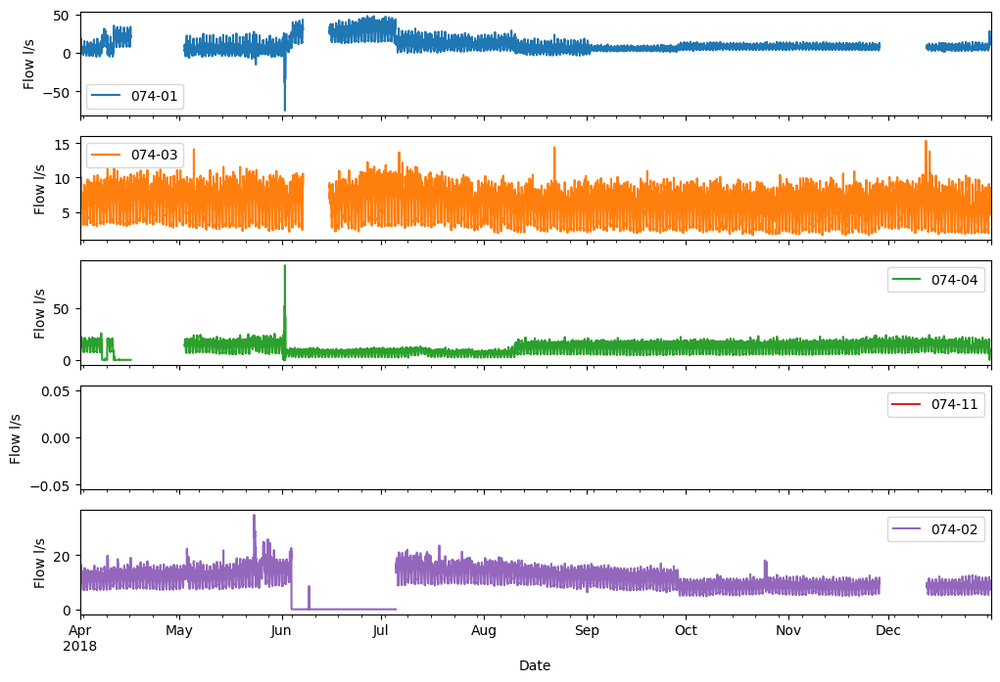

In [ ]:
#2018
import datetime as dt
df['Date'] = pd.to_datetime(df['Date'])
df_2018=df[df['Date'].dt.year==2018]
df_2018.set_index('Date')[['074-01', '074-03', '074-04', '074-11', '074-02']].plot(subplots=True, ylabel = 'Flow l/s')
plt.rcParams["figure.figsize"] = (15,8)

array([<Axes: xlabel='Date', ylabel='Flow l/s'>,
       <Axes: xlabel='Date', ylabel='Flow l/s'>,
       <Axes: xlabel='Date', ylabel='Flow l/s'>,
       <Axes: xlabel='Date', ylabel='Flow l/s'>,
       <Axes: xlabel='Date', ylabel='Flow l/s'>], dtype=object)

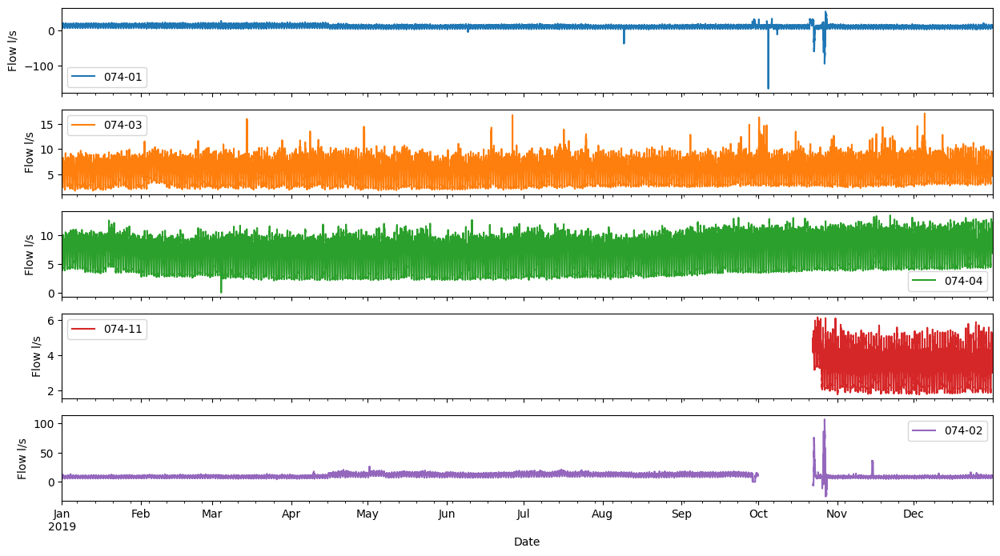

In [ ]:
#2019
df_2019=df[df['Date'].dt.year==2019]
df_2019.set_index('Date')[['074-01', '074-03', '074-04', '074-11', '074-02']].plot(subplots=True,ylabel = 'Flow l/s')

array([<Axes: xlabel='Date', ylabel='Flow l/s'>,
       <Axes: xlabel='Date', ylabel='Flow l/s'>,
       <Axes: xlabel='Date', ylabel='Flow l/s'>,
       <Axes: xlabel='Date', ylabel='Flow l/s'>,
       <Axes: xlabel='Date', ylabel='Flow l/s'>], dtype=object)

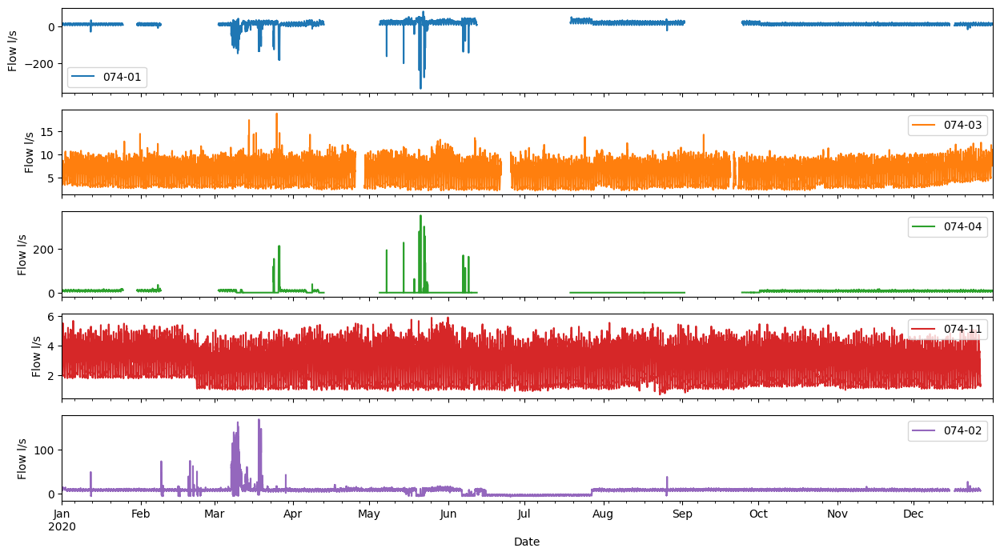

In [ ]:
df_2020=df[df['Date'].dt.year==2020]
df_2020.set_index('Date')[['074-01', '074-03', '074-04', '074-11', '074-02']].plot(subplots=True, ylabel = 'Flow l/s')

array([<Axes: xlabel='Date', ylabel='Flow l/s'>,
       <Axes: xlabel='Date', ylabel='Flow l/s'>,
       <Axes: xlabel='Date', ylabel='Flow l/s'>,
       <Axes: xlabel='Date', ylabel='Flow l/s'>,
       <Axes: xlabel='Date', ylabel='Flow l/s'>], dtype=object)

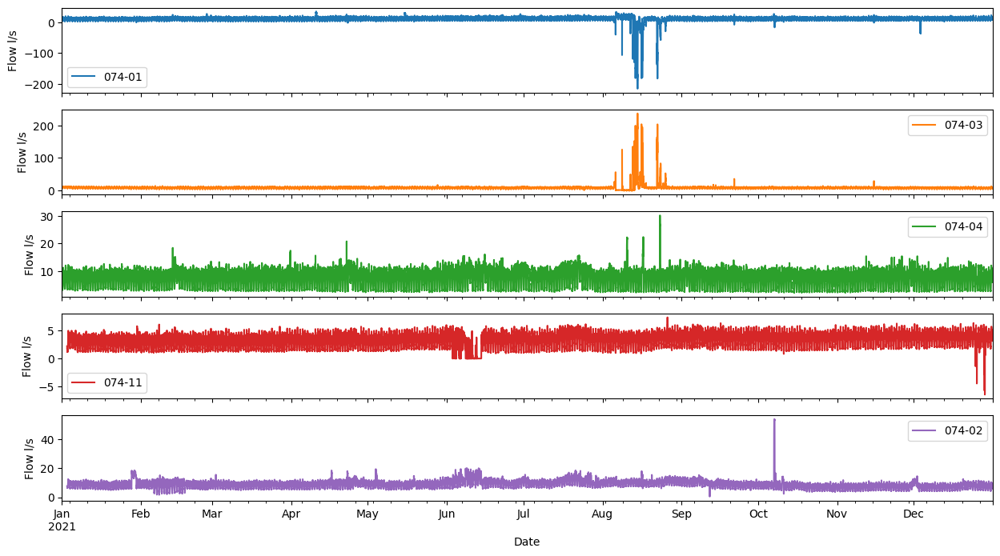

In [ ]:
df_2021=df[df['Date'].dt.year==2021]
df_2021.set_index('Date')[['074-01', '074-03', '074-04', '074-11', '074-02']].plot(subplots=True, ylabel = 'Flow l/s')

array([<Axes: xlabel='Date', ylabel='Flow l/s'>,
       <Axes: xlabel='Date', ylabel='Flow l/s'>,
       <Axes: xlabel='Date', ylabel='Flow l/s'>,
       <Axes: xlabel='Date', ylabel='Flow l/s'>,
       <Axes: xlabel='Date', ylabel='Flow l/s'>], dtype=object)

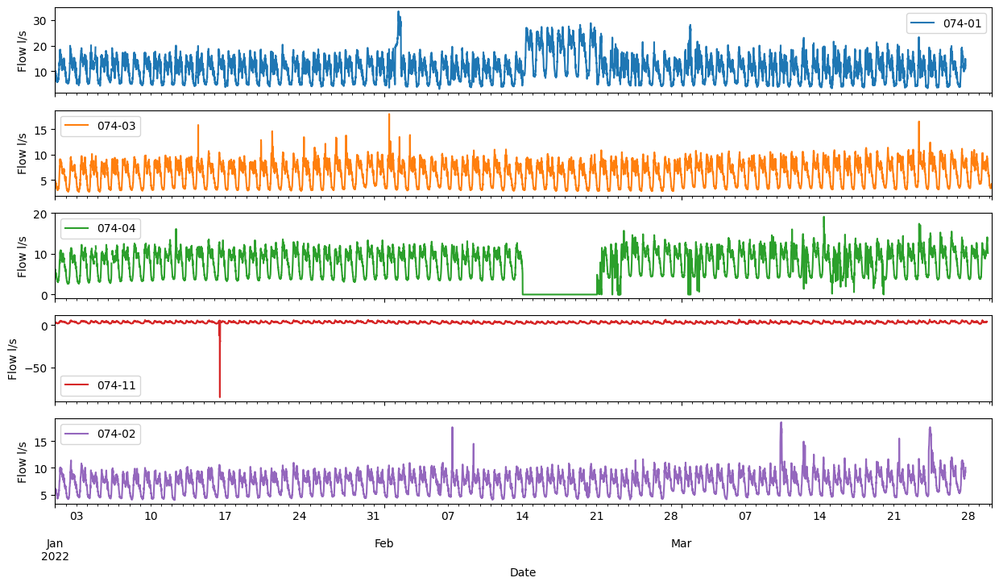

In [ ]:
df_2022=df[df['Date'].dt.year==2022]
df_2022.set_index('Date')[['074-01', '074-03', '074-04', '074-11', '074-02']].plot(subplots=True, ylabel = 'Flow l/s')

# **Handling Missing Values**

In [ ]:
from sklearn.impute import KNNImputer
imputer = KNNImputer(n_neighbors=96, weights="uniform")
df1=pd.DataFrame(imputer.fit_transform(df[['074-01','074-03','074-04','074-11','074-02']]))

In [ ]:
df1.rename(columns={0:'074-01',1:'074-03',2:'074-04',3:'074-11',4:'074-02'})

,074-01,074-03,074-04,074-11,074-02
0,-3.370818,4.622,12.244000,2.991667,8.889000
1,-3.286014,4.211,12.711000,2.992375,8.889000
2,-1.771281,3.644,10.978000,2.801510,8.556000
3,-1.574651,3.578,10.622000,2.622333,8.333000
4,-0.593511,3.422,9.622000,2.466542,8.111000
...,...,...,...,...,...
140081,6.101458,3.667,4.059396,1.859740,6.194573
140082,6.715688,3.789,3.949219,1.749510,6.764917
140083,4.361955,3.633,4.335083,1.740979,7.763302
140084,5.925577,4.244,6.492927,2.096042,7.271844


In [ ]:
df_date=df['Date']

In [ ]:
df = pd.concat([df_date, df1], axis=1)

In [ ]:
df.rename(columns={0:'074-01',1:'074-03',2:'074-04',3:'074-11',4:'074-02'},inplace = True)

**Handling Negative values**

In [ ]:
#Dealing with negative values
df['074-01'] = df['074-01'].apply(lambda x : x if x > 0 else df['074-01'].median())
df['074-03'] = df['074-03'].apply(lambda x : x if x > 0 else df['074-03'].median())
df['074-04'] = df['074-04'].apply(lambda x : x if x > 0 else df['074-04'].median())
df['074-11'] = df['074-11'].apply(lambda x : x if x > 0 else df['074-11'].median())
df['074-02'] = df['074-02'].apply(lambda x : x if x > 0 else df['074-02'].median())

In [ ]:
df

,Date,074-01,074-03,074-04,074-11,074-02
0,2018-04-01 00:00:00,11.377357,4.622,12.244000,2.991667,8.889000
1,2018-04-01 00:15:00,11.377357,4.211,12.711000,2.992375,8.889000
2,2018-04-01 00:30:00,11.377357,3.644,10.978000,2.801510,8.556000
3,2018-04-01 00:45:00,11.377357,3.578,10.622000,2.622333,8.333000
4,2018-04-01 01:00:00,11.377357,3.422,9.622000,2.466542,8.111000
...,...,...,...,...,...,...
140081,2022-03-30 04:15:00,6.101458,3.667,4.059396,1.859740,6.194573
140082,2022-03-30 04:30:00,6.715688,3.789,3.949219,1.749510,6.764917
140083,2022-03-30 04:45:00,4.361955,3.633,4.335083,1.740979,7.763302
140084,2022-03-30 05:00:00,5.925577,4.244,6.492927,2.096042,7.271844


## **Visualization of Processed Data**

array([<Axes: xlabel='Date', ylabel='Flow l/s'>,
       <Axes: xlabel='Date', ylabel='Flow l/s'>,
       <Axes: xlabel='Date', ylabel='Flow l/s'>,
       <Axes: xlabel='Date', ylabel='Flow l/s'>,
       <Axes: xlabel='Date', ylabel='Flow l/s'>], dtype=object)

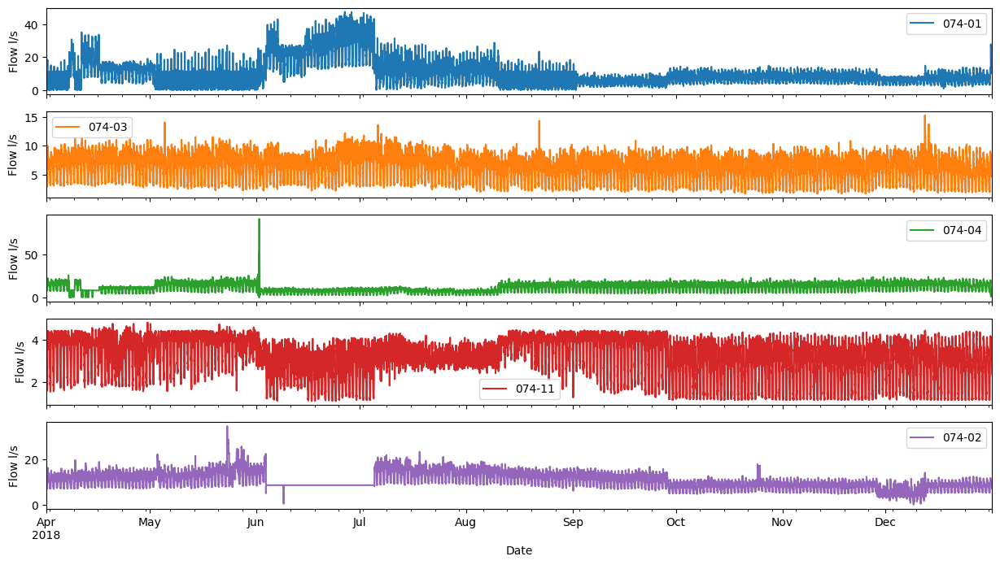

In [ ]:
df=df[['074-01', '074-03', '074-04', '074-11', '074-02']]
df_date = pd.date_range(pd.Timestamp("2018-04-01 00:00"),"2022-03-30 05:15" , freq='15Min')
df_date= pd.DataFrame(df_date)
df_date.rename(columns={0:'Date'}, inplace=True)
df= pd.concat([df_date,df], axis=1)
import datetime as dt
df_2018=df[df['Date'].dt.year==2018]
df_2018.set_index('Date')[['074-01', '074-03', '074-04', '074-11', '074-02']].plot(subplots=True, ylabel='Flow l/s')

# **LSTM Model**

In [ ]:
df_input = df[['074-01', '074-03', '074-04', '074-11', '074-02' ]]

In [ ]:
scaler = MinMaxScaler()
data_scaled = scaler.fit_transform(df_input)

In [ ]:
data_scaled

array([[0.14264537, 0.0193851 , 0.03484738, 0.40219494, 0.05274157],
       [0.14264537, 0.01766095, 0.0361777 , 0.40229051, 0.05274157],
       [0.14264537, 0.01528239, 0.03124101, 0.37653629, 0.05075324],
       ...,
       [0.05468291, 0.01523624, 0.01231775, 0.23343397, 0.04602006],
       [0.07428835, 0.01779939, 0.01846466, 0.28134417, 0.04308558],
       [0.07508018, 0.0164486 , 0.01245033, 0.2492424 , 0.03925514]])

In [ ]:
feature = data_scaled
target = data_scaled[:,0]

In [ ]:
x_train = feature[0:139894]
x_test = feature[139894:140086,:]
y_train = target[0:139894]
y_test = target[139894:140086]

In [ ]:
n_past = 96
batch_size = 100
num_feature = 5
train_generator = TimeseriesGenerator(x_train, y_train, length= n_past, sampling_rate=1, batch_size=batch_size)
test_generator = TimeseriesGenerator (x_test, y_test, length = n_past, sampling_rate=1, batch_size=batch_size)

In [ ]:
model = Sequential()
model.add(LSTM(128, input_shape=(n_past, num_feature), return_sequences=True))
model.add(LSTM(128,  return_sequences=True))
model.add(Dropout(0.3))
model.add(LSTM(64, return_sequences=False))
model.add(Dropout(0.2))
model.add(Dense(1))
model.compile(optimizer='adam', loss='mse')
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 96, 128)           68608     
                                                                 
 lstm_1 (LSTM)               (None, 96, 128)           131584    
                                                                 
 dropout (Dropout)           (None, 96, 128)           0         
                                                                 
 lstm_2 (LSTM)               (None, 64)                49408     
                                                                 
 dropout_1 (Dropout)         (None, 64)                0         
                                                                 
 dense (Dense)               (None, 1)                 65        
                                                                 
Total params: 249665 (975.25 KB)
Trainable params: 24966

In [ ]:
history = model.fit(train_generator, epochs=5, validation_data= test_generator, shuffle=False,  batch_size=150,  verbose=1)

Epoch 1/5
1398/1398 [==============================] - 999s 709ms/step - loss: 0.0015 - val_loss: 2.7824e-04
Epoch 2/5
1398/1398 [==============================] - 992s 710ms/step - loss: 6.1812e-04 - val_loss: 2.7712e-04
Epoch 3/5
1398/1398 [==============================] - 983s 703ms/step - loss: 5.5895e-04 - val_loss: 2.4786e-04
Epoch 4/5
1398/1398 [==============================] - 979s 701ms/step - loss: 5.3017e-04 - val_loss: 2.4583e-04
Epoch 5/5
1398/1398 [==============================] - 983s 703ms/step - loss: 5.2678e-04 - val_loss: 2.5574e-04


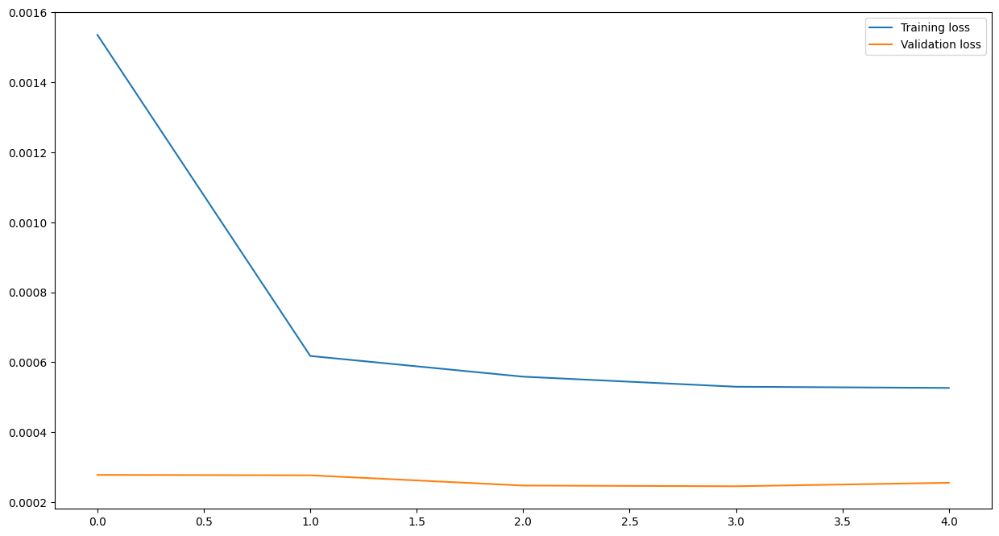

In [ ]:
plt.plot(history.history['loss'], label='Training loss')
plt.plot(history.history['val_loss'], label='Validation loss')
plt.rcParams["figure.figsize"] = (12.5,8.5)
plt.legend()

In [ ]:
predictions = model.predict(test_generator)
df_pred = pd.concat([pd.DataFrame(predictions), pd.DataFrame(x_test[:,0:4][n_past:])], axis=1)
rev_trans = scaler.inverse_transform(df_pred)
rev_trans

1/1 [==============================] - 2s 2s/step


array([[8.95469675e+00, 2.79442181e+01, 6.98981212e+00, 1.03889516e-01,
        5.32979123e+01],
       [9.41048461e+00, 2.94289956e+01, 7.56855725e+00, 1.19364064e-01,
        5.07668876e+01],
       [9.83092902e+00, 2.71195212e+01, 7.23868725e+00, 1.28061901e-01,
        5.78175992e+01],
       [9.80245115e+00, 3.42220494e+01, 7.98825792e+00, 1.48223148e-01,
        6.00774427e+01],
       [1.08384560e+01, 3.74095101e+01, 8.71868434e+00, 1.64183256e-01,
        6.76027215e+01],
       [1.20341163e+01, 4.20687816e+01, 9.92035361e+00, 1.99840163e-01,
        8.54328865e+01],
       [1.35849665e+01, 4.35471318e+01, 1.06021831e+01, 2.00304611e-01,
        8.19301291e+01],
       [1.44848468e+01, 4.76078087e+01, 1.24577018e+01, 2.36658189e-01,
        9.11954874e+01],
       [1.55265609e+01, 4.95552525e+01, 1.35312520e+01, 2.50253836e-01,
        1.10788330e+02],
       [1.63566979e+01, 4.60407102e+01, 1.29009647e+01, 2.77951801e-01,
        1.09522818e+02],
       [1.60738029e+01, 4.9514

In [ ]:
df_final=df_input[predictions.shape[0]*-1:]
df_final['074-01_pred'] = rev_trans[:,0]
df_final

<ipython-input-43-5f8488e0c2e4>:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,074-01,074-03,074-04,074-11,074-02,074-01_pred
139990,9.349714,4.740,4.411000,2.367000,5.090854,8.954697
139991,9.846476,5.133,5.144000,2.255000,7.300740,9.410485
139992,9.073795,4.909,5.556000,2.567000,6.244208,9.830929
139993,11.450089,5.418,6.511000,2.667000,6.066219,9.802451
139994,12.516518,5.914,7.267000,3.000000,5.416938,10.838456
...,...,...,...,...,...,...
140081,6.101458,3.667,4.059396,1.859740,6.194573,5.343806
140082,6.715688,3.789,3.949219,1.749510,6.764917,5.747320
140083,4.361955,3.633,4.335083,1.740979,7.763302,6.282894
140084,5.925577,4.244,6.492927,2.096042,7.271844,5.555135


In [ ]:
test_date = pd.date_range(pd.Timestamp("2022-03-29 05:30:00"),"2022-03-30 05:15" , freq='15Min')
test_date = pd.DataFrame(test_date)
test_date.rename(columns={0:'Date'}, inplace=True)

In [ ]:
df_final.reset_index(inplace=True)
df_finals = pd.concat([test_date, df_final],  axis=1)
df_finals.drop(['index','074-03', '074-04', '074-11','074-02'], axis=1, inplace=True)
df_finals

,Date,074-01,074-01_pred
0,2022-03-29 05:30:00,9.349714,8.954697
1,2022-03-29 05:45:00,9.846476,9.410485
2,2022-03-29 06:00:00,9.073795,9.830929
3,2022-03-29 06:15:00,11.450089,9.802451
4,2022-03-29 06:30:00,12.516518,10.838456
...,...,...,...
91,2022-03-30 04:15:00,6.101458,5.343806
92,2022-03-30 04:30:00,6.715688,5.747320
93,2022-03-30 04:45:00,4.361955,6.282894
94,2022-03-30 05:00:00,5.925577,5.555135


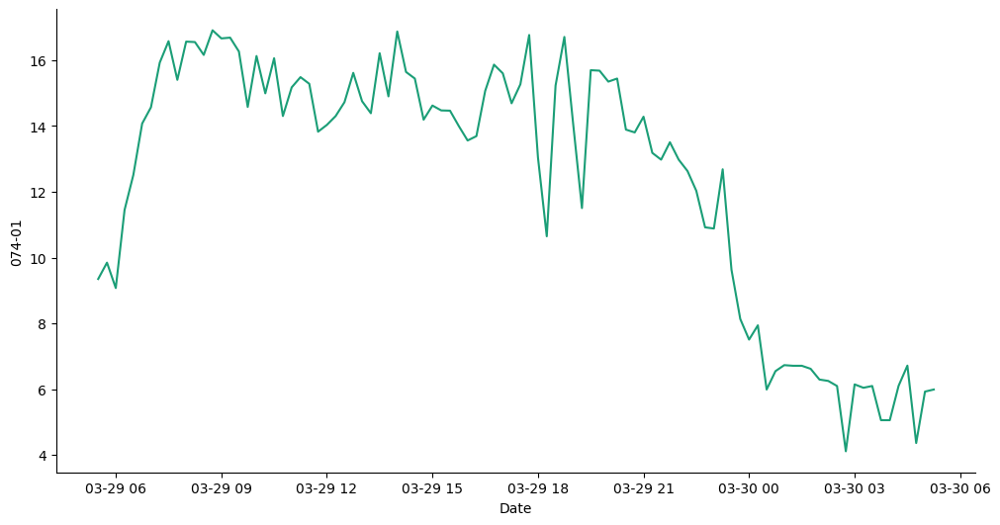

In [ ]:
# @title Date vs 074-01

from matplotlib import pyplot as plt
import seaborn as sns
def _plot_series(series, series_name, series_index=0):
  palette = list(sns.palettes.mpl_palette('Dark2'))
  xs = series['Date']
  ys = series['074-01']

  plt.plot(xs, ys, label=series_name, color=palette[series_index % len(palette)])

fig, ax = plt.subplots(figsize=(10, 5.2), layout='constrained')
df_sorted = df_finals.sort_values('Date', ascending=True)
_plot_series(df_sorted, '')
sns.despine(fig=fig, ax=ax)
plt.xlabel('Date')
_ = plt.ylabel('074-01')

<Axes: ylabel='074-01'>

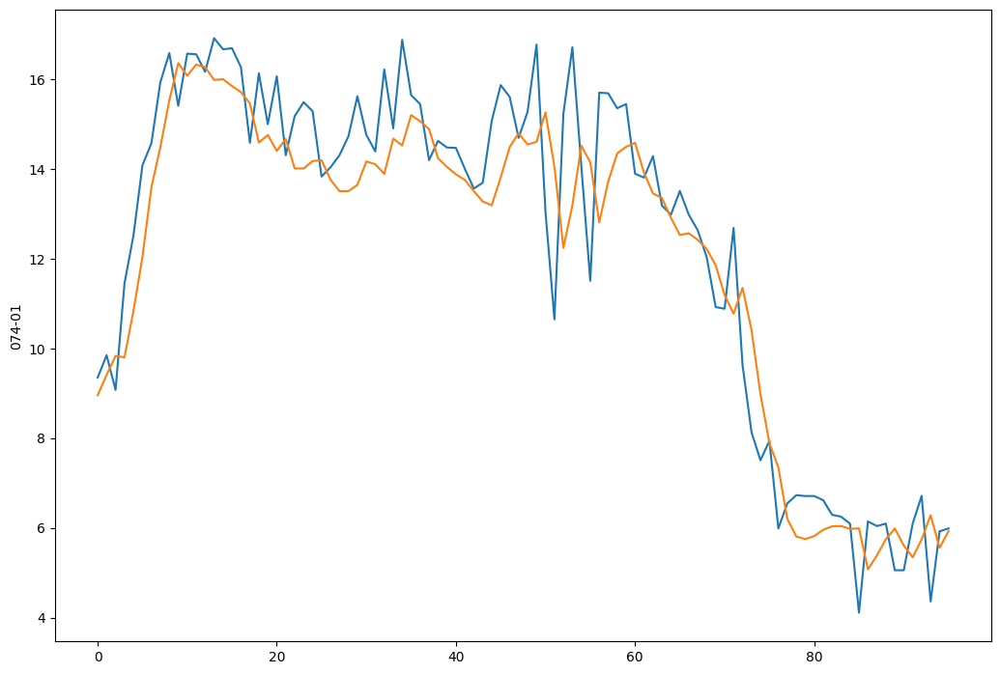

In [ ]:
#plot the original data with predictions
sns.lineplot( df_finals['074-01'])
sns.lineplot(df_finals['074-01_pred'])

**Root Mean Square Error**

In [ ]:
#Root Mean Square Error
rmse = np.sqrt(np.mean(((df_finals['074-01_pred'] - df_finals['074-01'])**2)))
rmse

1.2754231314513642

**Mean Squared Error**

In [ ]:
from sklearn.metrics import mean_absolute_error as mae
mae(df_finals['074-01'], df_finals['074-01_pred'])

0.9933058535703131

In [ ]:
#Mean absolute percentage error
mape = np.mean(np.abs((df_finals['074-01']-df_finals['074-01_pred']) / df_finals['074-01']))*100
mape

8.988405876054902

**Prediction of next 24 hours of 074-01**

In [ ]:
scaler = MinMaxScaler()
scaler = scaler.fit(df_input)
df_for_training_scaled = scaler.transform(df_input)
trainX = []
trainY = []

n_future = 96   # Number of datapointsto look into the future based on the past data.
n_past = 96  # Number of past datapoints used to predict the future.
for i in range(n_past, len(df_for_training_scaled) - n_future +1):
    trainX.append(df_for_training_scaled[i - n_past:i, 0:df_for_training_scaled.shape[1]])
    trainY.append(df_for_training_scaled[i + n_future - 1:i + n_future, 0])
trainX, trainY = np.array(trainX), np.array(trainY)
forecast=model.predict(trainX[-n_future:])
forecast_copies = np.repeat(forecast, df_for_training_scaled.shape[1], axis=-1)
y_pred_future = scaler.inverse_transform(forecast_copies)[:,0]
forecast_period_dates = pd.date_range(pd.Timestamp("2022-03-30 05:30"),"2022-03-31 05:15" , freq='15Min')
df_forecast = pd.DataFrame({'Date':np.array(forecast_period_dates) , '074-01':y_pred_future})
df_forecast['Date'] = pd.to_datetime(df_forecast['Date'])

original = df[['Date' , '074-01']]
original['Date'] = pd.to_datetime(original['Date'])
original = original.loc[original['Date']>='2022-03-30']
df_forecast

3/3 [==============================] - 2s 108ms/step


<ipython-input-51-128a3b1cbdaa>:21: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,Date,074-01
0,2022-03-30 05:30:00,8.702829
1,2022-03-30 05:45:00,9.449735
2,2022-03-30 06:00:00,9.753421
3,2022-03-30 06:15:00,10.957248
4,2022-03-30 06:30:00,12.252177
...,...,...
91,2022-03-31 04:15:00,8.955800
92,2022-03-31 04:30:00,8.428937
93,2022-03-31 04:45:00,8.304879
94,2022-03-31 05:00:00,8.339331


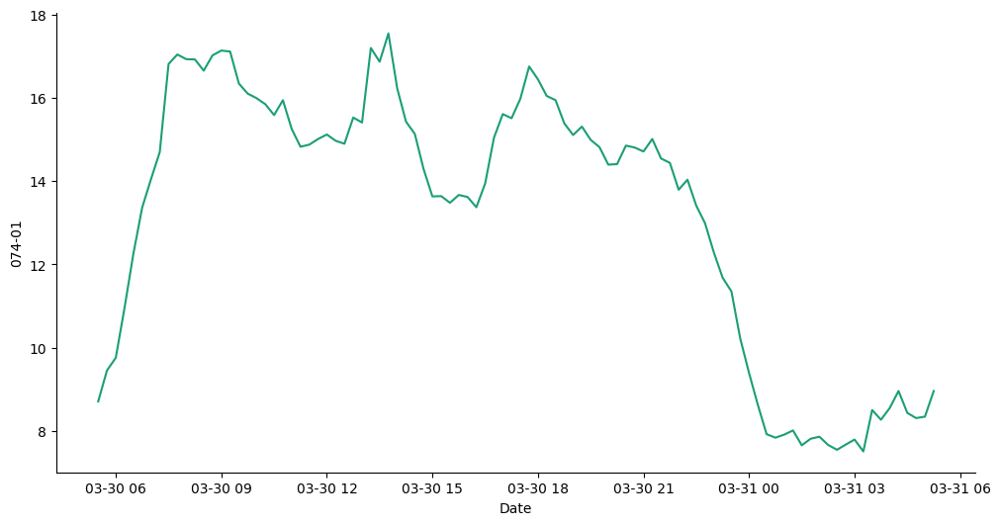

In [ ]:

from matplotlib import pyplot as plt
import seaborn as sns
def _plot_series(series, series_name, series_index=0):
  palette = list(sns.palettes.mpl_palette('Dark2'))
  xs = series['Date']
  ys = series['074-01']

  plt.plot(xs, ys, label=series_name, color=palette[series_index % len(palette)])

fig, ax = plt.subplots(figsize=(10, 5.2), layout='constrained')
df_sorted = df_forecast.sort_values('Date', ascending=True)
_plot_series(df_sorted, '')
sns.despine(fig=fig, ax=ax)
plt.xlabel('Date')
_ = plt.ylabel('074-01')

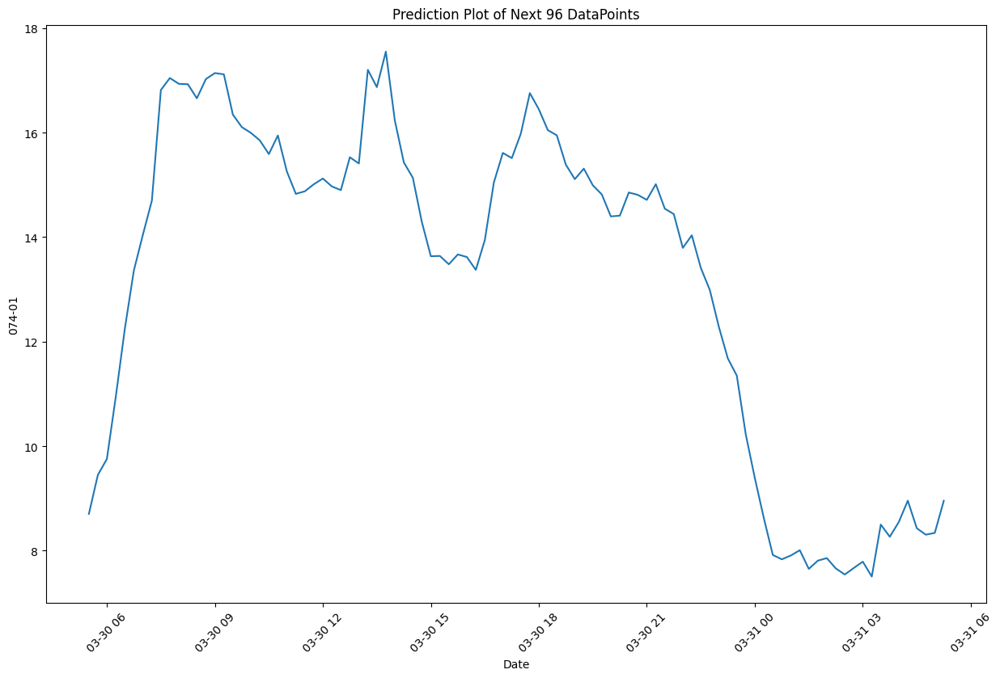

In [ ]:
sns.lineplot(x='Date', y='074-01', data=df_forecast)
plt.title('Prediction Plot of Next 96 DataPoints')
plt.xlabel('Date')
plt.ylabel('074-01')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()
